In [243]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import pathlib
from sklearn.model_selection import train_test_split

In [244]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

In [245]:
import IPython.display as display
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os

In [246]:
# checking Tensorflow version
tf.__version__

'2.2.0'

In [247]:
data_dir = pathlib.Path('./images/train/')

In [248]:
data_dir

PosixPath('images/train')

In [249]:
image_count = len(list(data_dir.glob('*/*.jpg')))
image_count

5887

In [250]:
images = list(data_dir.glob('*/*.jpg'))

In [251]:
CLASS_NAMES = np.array(['healthy', 'pneumonia', 'covid'])
CLASS_NAMES

array(['healthy', 'pneumonia', 'covid'], dtype='<U9')

In [252]:
healthy = list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [253]:
len(healthy) + len(pneumonia) + len(covid)

5887

In [254]:
print(f'healthy lungs: {len(healthy)} images')
print(f'pneumonia lungs: {len(pneumonia)} images')
print(f'coivd lungs: {len(covid)} images')

healthy lungs: 1965 images
pneumonia lungs: 3723 images
coivd lungs: 199 images


In [ ]:
# Leave 80%, 10%, 10% split for train, val, test


In [14]:
# confusion matrix, misclassifications

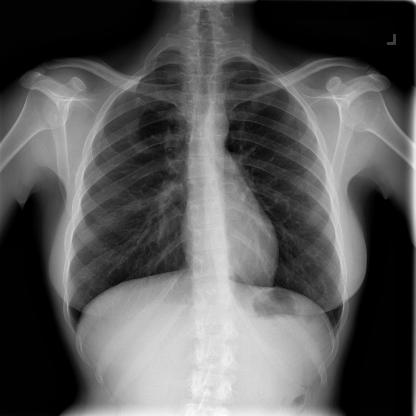

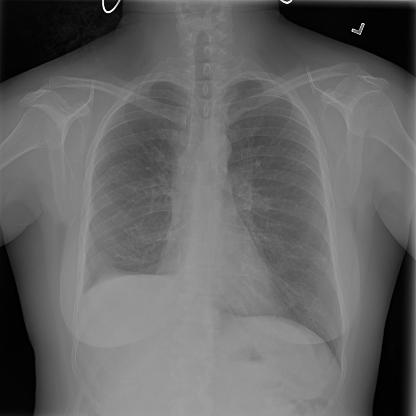

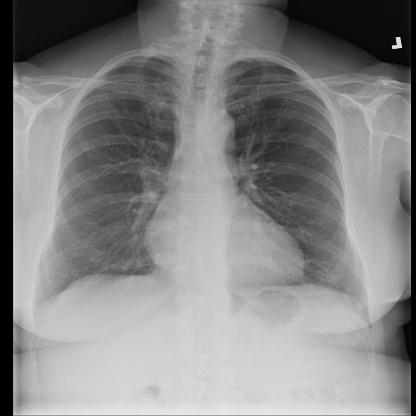

In [232]:
for image_path in healthy[3:6]:
    display.display(Image.open(str(image_path)))


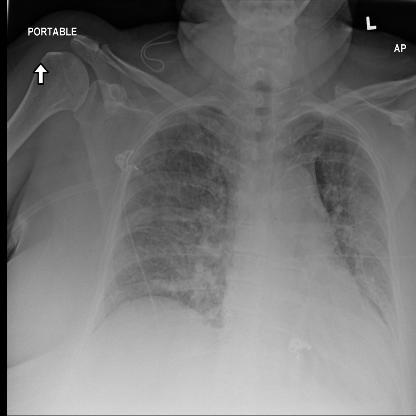

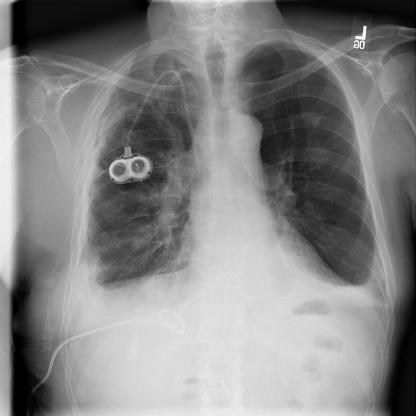

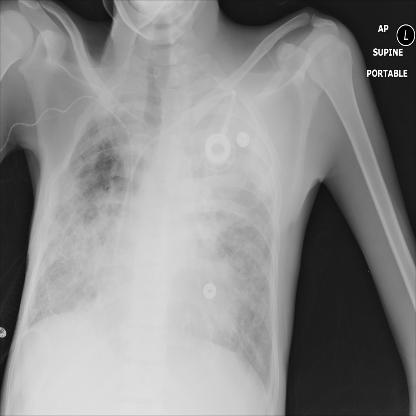

In [236]:
for image_path in pneumonia[15:18]:
    display.display(Image.open(str(image_path)))

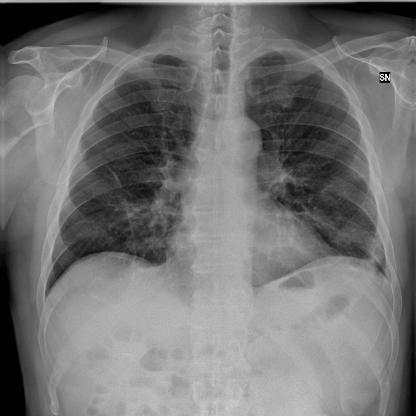

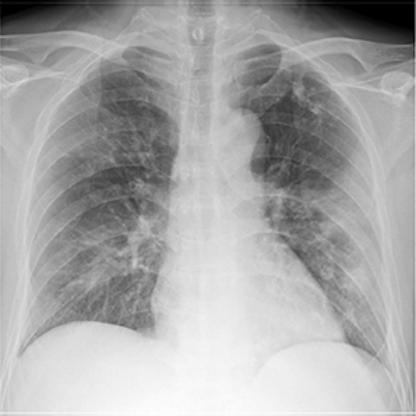

In [242]:
for image_path in covid[19:21]:
    display.display(Image.open(str(image_path)))

# Load using Keras

In [16]:
# The 1./255 is to convert from uint8 to float32 in range [0,1].
random_state = 42
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255, validation_split=0.2)

In [17]:
BATCH_SIZE = 32
IMG_HEIGHT = 224
IMG_WIDTH = 224
STEPS_PER_EPOCH = np.ceil(image_count/BATCH_SIZE)

In [18]:
train_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='training')
val_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='validation')

Found 4711 images belonging to 3 classes.
Found 1176 images belonging to 3 classes.


In [19]:
4711 + 1176

5887

In [24]:
def show_batch(image_batch, label_batch):
  plt.figure(figsize=(10,10))
  for n in range(25):
      ax = plt.subplot(5,5,n+1)
      plt.imshow(image_batch[n])
      plt.title(CLASS_NAMES[label_batch[n]==1][0].title())
      plt.axis('off')

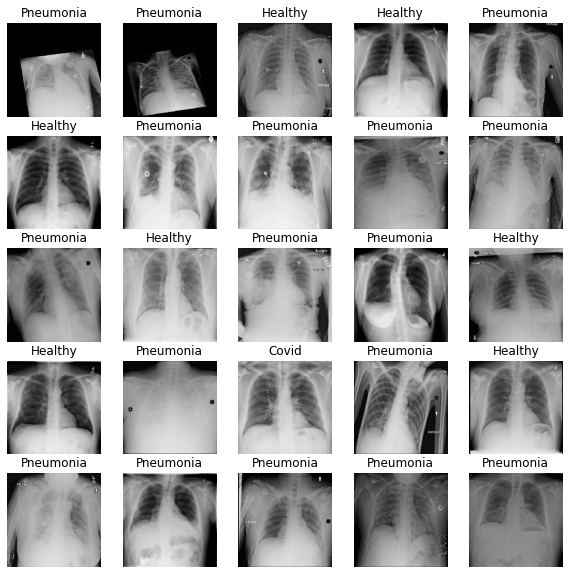

In [25]:
image_batch, label_batch = next(train_data_gen)
show_batch(image_batch, label_batch)

# MobileNet V2 model

In [26]:
# Initiate model
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [27]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 7, 7, 1280)


In [28]:
# Freeze the convolutional base
base_model.trainable = False

In [29]:
# Base model architecture
base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
_______________________________________________________________________________

In [30]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [31]:
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [32]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [33]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(lr=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [34]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 3,843
Non-trainable params: 2,257,984
_________________________________________________________________


In [35]:
len(model.trainable_variables)

2

In [36]:
initial_epochs = 10
validation_steps =20

loss0,accuracy0 = model.evaluate(val_data_gen, steps = validation_steps)

20/20 [==============================] - 20s 1s/step - loss: 0.8398 - accuracy: 0.3063


In [37]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 0.84
initial accuracy: 0.31


In [38]:
history = model.fit(train_data_gen,
                    epochs=initial_epochs,
                    validation_data=val_data_gen)

Epoch 1/10
148/148 [==============================] - 250s 2s/step - loss: 0.5073 - accuracy: 0.6079 - val_loss: 0.4127 - val_accuracy: 0.7228
Epoch 2/10
148/148 [==============================] - 194s 1s/step - loss: 0.3881 - accuracy: 0.7499 - val_loss: 0.3612 - val_accuracy: 0.7730
Epoch 3/10
148/148 [==============================] - 194s 1s/step - loss: 0.3512 - accuracy: 0.7786 - val_loss: 0.3373 - val_accuracy: 0.7866
Epoch 4/10
148/148 [==============================] - 194s 1s/step - loss: 0.3323 - accuracy: 0.7888 - val_loss: 0.3249 - val_accuracy: 0.7891
Epoch 5/10
148/148 [==============================] - 195s 1s/step - loss: 0.3202 - accuracy: 0.7977 - val_loss: 0.3205 - val_accuracy: 0.7900
Epoch 6/10
148/148 [==============================] - 195s 1s/step - loss: 0.3114 - accuracy: 0.8011 - val_loss: 0.3120 - val_accuracy: 0.7900
Epoch 7/10
148/148 [==============================] - 195s 1s/step - loss: 0.3051 - accuracy: 0.8045 - val_loss: 0.3076 - val_accuracy: 0.7908

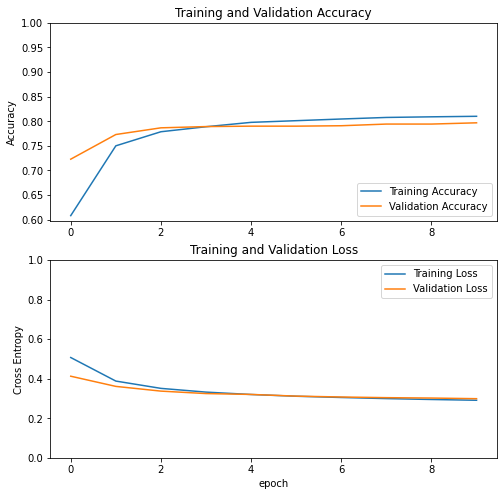

In [39]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [40]:
base_model.trainable = True

In [41]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

Number of layers in the base model:  155


In [42]:
# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [43]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.RMSprop(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [44]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 1,866,435
Non-trainable params: 395,392
_________________________________________________________________


In [45]:
len(model.trainable_variables)

58

In [49]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_data_gen,
                         epochs = total_epochs,
                         initial_epoch =  history.epoch[-1],
                         validation_data = val_data_gen)

Epoch 10/20
148/148 [==============================] - 304s 2s/step - loss: 0.4009 - accuracy: 0.7533 - val_loss: 0.3196 - val_accuracy: 0.7942
Epoch 11/20
148/148 [==============================] - 301s 2s/step - loss: 0.2920 - accuracy: 0.8168 - val_loss: 0.3110 - val_accuracy: 0.8010
Epoch 12/20
148/148 [==============================] - 302s 2s/step - loss: 0.2566 - accuracy: 0.8440 - val_loss: 0.3050 - val_accuracy: 0.8070
Epoch 13/20
148/148 [==============================] - 300s 2s/step - loss: 0.2306 - accuracy: 0.8559 - val_loss: 0.3050 - val_accuracy: 0.8112
Epoch 14/20
148/148 [==============================] - 301s 2s/step - loss: 0.2084 - accuracy: 0.8726 - val_loss: 0.3024 - val_accuracy: 0.8163
Epoch 15/20
148/148 [==============================] - 347s 2s/step - loss: 0.1908 - accuracy: 0.8881 - val_loss: 0.3013 - val_accuracy: 0.8180
Epoch 16/20
148/148 [==============================] - 301s 2s/step - loss: 0.1684 - accuracy: 0.9021 - val_loss: 0.3083 - val_accuracy:

In [53]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

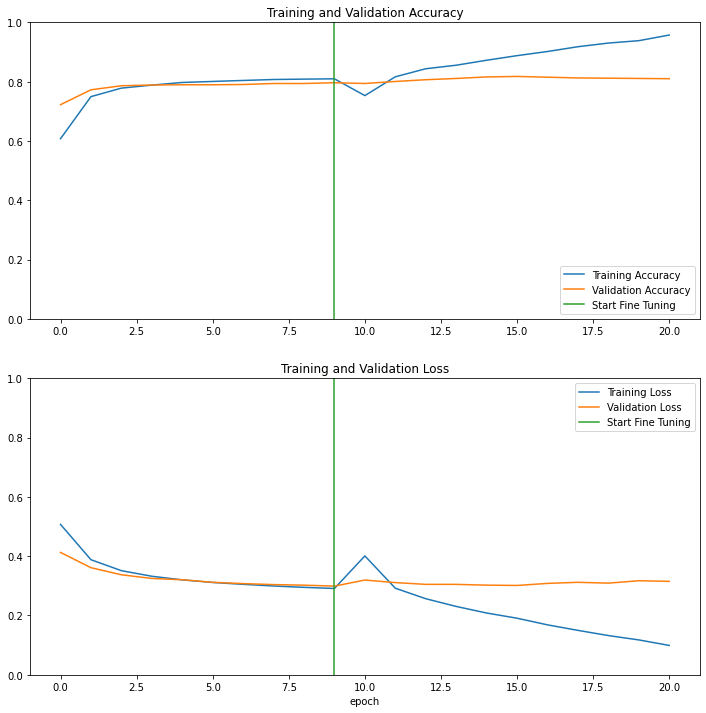

In [54]:
plt.figure(figsize=(12, 12))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# Keras 2

# Changed base model trainable to TRUE. How to convert to gray scale

In [55]:
random_state = 42

In [ ]:
(raw_train, raw_validation, raw_test), metadata = tfds.load(
    'cats_vs_dogs',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    with_info=True,
    as_supervised=True,
)

In [ ]:
tfds.load(
    name, split=None, data_dir=None, batch_size=None, shuffle_files=False,
    download=True, as_supervised=False, decoders=None, read_config=None,
    with_info=False, builder_kwargs=None, download_and_prepare_kwargs=None,
    as_dataset_kwargs=None, try_gcs=False
)

In [ ]:
IMG_SIZE = 160

def format_example(image, label):
  image = tf.cast(image, tf.float32)
  image = (image/127.5) - 1
  image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
  return image, label

In [11]:
BATCH_SIZE = 32
IMG_HEIGHT = 224
IMG_WIDTH = 224
STEPS_PER_EPOCH = np.ceil(image_count/BATCH_SIZE)

In [16]:
train_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='training')
val_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='validation')

Found 4711 images belonging to 3 classes.
Found 1176 images belonging to 3 classes.


In [17]:
# Initiate model
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [19]:
# Unfreeze the convolutional base
base_model.trainable = True

In [ ]:
# check if can freeze earlier layers then unfreeze later ones
# deep learning with python

In [23]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 7, 7, 1280)


In [24]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [25]:
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [26]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [27]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(lr=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [28]:
initial_epochs = 10
validation_steps =20

loss0,accuracy0 = model.evaluate(train_data_gen, steps = validation_steps)

20/20 [==============================] - 22s 1s/step - loss: 1.2184 - accuracy: 0.0328


In [29]:
print("Number of layers in the base model: ", len(base_model.layers))

Number of layers in the base model:  155


In [30]:
# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [31]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.RMSprop(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [32]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 1,866,435
Non-trainable params: 395,392
_________________________________________________________________


In [33]:
len(model.trainable_variables)

58

In [34]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_batches,
                         epochs=total_epochs,
                         initial_epoch =  history.epoch[-1],
                         validation_data=validation_batches)

NameError: name 'train_batches' is not defined

In [225]:
history2 = model.fit(train_data_gen,
                    epochs=initial_epochs,
                    validation_data=val_data_gen)

Epoch 1/10
148/148 [==============================] - 1009s 7s/step - loss: 0.1404 - accuracy: 0.9168 - val_loss: 0.9161 - val_accuracy: 0.6556
Epoch 2/10
148/148 [==============================] - 884s 6s/step - loss: 0.0689 - accuracy: 0.9624 - val_loss: 0.5160 - val_accuracy: 0.7747
Epoch 3/10
148/148 [==============================] - 776s 5s/step - loss: 0.0327 - accuracy: 0.9839 - val_loss: 0.8705 - val_accuracy: 0.7721
Epoch 4/10
148/148 [==============================] - 782s 5s/step - loss: 0.0247 - accuracy: 0.9875 - val_loss: 1.1218 - val_accuracy: 0.7568
Epoch 5/10
148/148 [==============================] - 950s 6s/step - loss: 0.0202 - accuracy: 0.9902 - val_loss: 2.9432 - val_accuracy: 0.4592
Epoch 6/10
148/148 [==============================] - 818s 6s/step - loss: 0.0219 - accuracy: 0.9875 - val_loss: 0.7906 - val_accuracy: 0.7985
Epoch 7/10
148/148 [==============================] - 782s 5s/step - loss: 0.0179 - accuracy: 0.9913 - val_loss: 1.4150 - val_accuracy: 0.716

# CNN

In [227]:
random_state = 42

In [ ]:
healthy = pd.read_

In [237]:
BATCH_SIZE_train = 4711
BATCH_SIZE_test = 1176

In [238]:
train_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE_train,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='training')
val_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE_test,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='validation')

Found 4711 images belonging to 3 classes.
Found 1176 images belonging to 3 classes.


In [264]:
image_batch, label_batch = next(train_data_gen)

In [244]:
image_batch_val, label_batch_val = next(val_data_gen)

In [257]:
type(image_batch)

numpy.ndarray

In [246]:
print(f'train: {len(image_batch)}')
print(f'val: {len(image_batch_val)}')

train: 4711
val: 1176


In [262]:
X_test = image_batch_val.reshape((1176, 28, 28, 1))

ValueError: cannot reshape array of size 177020928 into shape (1176,28,28,1)

In [ ]:
y_train = to_categorical(y_train, 10)

In [ ]:
image_batch, label_batch = next(train_data_gen)

In [ ]:
model = Sequential()
model.add(Conv2D(filters=32,            
                     kernel_size=(3, 3),        
                     activation='relu',      
                     input_shape=(28, 28, 1))) 
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(16,
                     kernel_size = (3, 3),
                     activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(8,
                     kernel_size = (3, 3),
                     activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(10, activation='softmax'))

In [ ]:
model.compile(loss='categorical_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])

In [ ]:
history2 = model.fit(X_train,
                        y_train,
                        batch_size=32,
                        validation_data=(X_val, y_val),
                        epochs=10,
                        verbose=1)

In [ ]:
pred = model.predict(X_test)

# Load using tf

In [312]:
list_ds = tf.data.Dataset.list_files(str(data_dir/'*/*'))

In [256]:
for f in list_ds.take(5):
  print(f.numpy())

b'images/train/healthy/6518f095-9599-4dcb-bbba-5cc260babfef_jpg.rf.e75fab2d362c86cc134ec137fdebb690.jpg'
b'images/train/healthy/80c28f3e-bbf1-44db-a4e0-cd8d6411dd62_jpg.rf.26466cc45c6bead73a369d77a2d38c9b.jpg'
b'images/train/pneumonia/f22259a4-daac-4444-85cf-fc542c88be33_jpg.rf.e6d9e3b22d73a7b4dc7f9ae8ddf911fa.jpg'
b'images/train/healthy/cf7b4277-f473-41da-af06-b7efe122a61d_jpg.rf.428f4c04156c1cf1e6dcb5f74909865f.jpg'
b'images/train/pneumonia/48029094-265a-43e6-9e29-455237085578_jpg.rf.132d03151e2273b204cddf9f536f7a92.jpg'


In [257]:
for f in list_ds.take(5):
  print(f.numpy())

b'images/train/pneumonia/554f03bf-99bd-468f-9e88-a069168dacca_jpg.rf.da65a59aaa9b042f2ebbb6781de4b0c5.jpg'
b'images/train/healthy/96ec3ac3-3842-40b9-8874-f0130e46064b_jpg.rf.ec888a7c7ad0559054712425e0b9dad5.jpg'
b'images/train/pneumonia/4dda80b9-1f21-41aa-bbf0-84bd252cace3_jpg.rf.f084f3a20283b6a57c99009f7d04dd84.jpg'
b'images/train/pneumonia/db7bcaae-0652-496b-aae1-ded12161e468_jpg.rf.b08b1b59af94fe34b33763d090d3e781.jpg'
b'images/train/pneumonia/2d2679da-35e6-49fb-a703-52aadee243ea_jpg.rf.d90feb3f5741b9ce259902fe4342718d.jpg'


In [19]:
def get_label(file_path):
  # convert the path to a list of path components
  parts = tf.strings.split(file_path, os.path.sep)
  # The second to last is the class-directory
  return parts[-2] == CLASS_NAMES

In [20]:
def decode_img(img):
  # convert the compressed string to a 3D uint8 tensor
  img = tf.image.decode_jpeg(img, channels=3)
  # Use `convert_image_dtype` to convert to floats in the [0,1] range.
  img = tf.image.convert_image_dtype(img, tf.float32)
  # resize the image to the desired size.
  return tf.image.resize(img, [IMG_WIDTH, IMG_HEIGHT])

In [21]:
def process_path(file_path):
  label = get_label(file_path)
  # load the raw data from the file as a string
  img = tf.io.read_file(file_path)
  img = decode_img(img)
  return img, label

In [28]:
def prepare_for_training(ds, cache=True, shuffle_buffer_size=1000):

  if cache:
    if isinstance(cache, str):
      ds = ds.cache(cache)
    else:
      ds = ds.cache()

  ds = ds.shuffle(buffer_size=shuffle_buffer_size)

  # Repeat forever
  ds = ds.repeat()

  ds = ds.batch(BATCH_SIZE)

  # `prefetch` lets the dataset fetch batches in the background while the model
  # is training.
  ds = ds.prefetch(buffer_size=AUTOTUNE)

  return ds

In [26]:
# Set `num_parallel_calls` so multiple images are loaded/processed in parallel.
IMG_WIDTH = 160
IMG_HEIGHT = 160

labeled_train = list_ds.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_val = list_ds.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_test = list_ds.map(process_path, num_parallel_calls=AUTOTUNE)

In [27]:
for image, label in labeled_ds.take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

Image shape:  (224, 224, 3)
Label:  [False  True False]


In [ ]:
for image_path in healthy[3:6]:
    display.display(Image.open(str(image_path)))

In [23]:
ds = prepare_for_training(labeled_ds)

image_batch, label_batch = next(iter(ds))

NameError: name 'prepare_for_training' is not defined

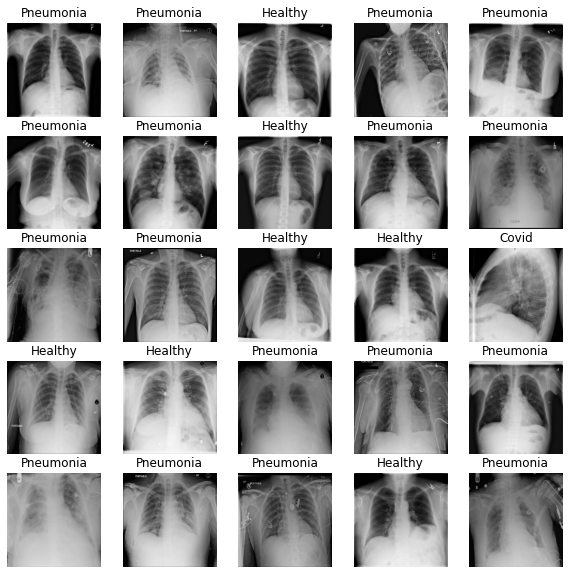

In [32]:
show_batch(image_batch.numpy(), label_batch.numpy())

In [33]:
val_data_size = int(0.2 * image_count)
val_data = ds.take(val_data_size)
train_data = ds.skip(val_data_size)
test_data_size = int(0.1 * image_count)
test_data = ds.take(test_data_size)
val_data = ds.skip(test_data_size)

In [34]:
val_data = tf.data.Dataset.from_generator(lambda: map(tuple, val_data), (tf.float32))
train_data = tf.data.Dataset.from_generator(lambda: map(tuple, train_data), (tf.float32))
test_data = tf.data.Dataset.from_generator(lambda: map(tuple, test_data), (tf.float32))

In [ ]:
for image_batch, label_batch in train_data.take(1):
   pass

image_batch.shape

In [97]:
for image_batch, label_batch in val_data.take(1):
   pass

image_batch.shape

TensorShape([32, 224, 224, 3])

In [111]:
IMG_SIZE = 224

IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [112]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 7, 7, 1280)


In [113]:
base_model.trainable = False

In [114]:
base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_3[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
_______________________________________________________________________________

In [115]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [116]:
prediction_layer = tf.keras.layers.Dense(1)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 1)


In [117]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [118]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(lr=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [119]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_3 ( (None, 1280)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 1281      
Total params: 2,259,265
Trainable params: 1,281
Non-trainable params: 2,257,984
_________________________________________________________________


In [137]:
initial_epochs = 10
validation_steps = 20

loss0,accuracy0 = model.evaluate(train_data, steps = validation_steps)

ValueError: in user code:

    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:941 test_function  *
        outputs = self.distribute_strategy.run(
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:951 run  **
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2290 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2649 _call_for_each_replica
        return fn(*args, **kwargs)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:912 test_step  **
        y, y_pred, sample_weight, regularization_losses=self.losses)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/engine/compile_utils.py:205 __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/losses.py:143 __call__
        losses = self.call(y_true, y_pred)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/losses.py:246 call
        return self.fn(y_true, y_pred, **self._fn_kwargs)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/losses.py:1595 binary_crossentropy
        K.binary_crossentropy(y_true, y_pred, from_logits=from_logits), axis=-1)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/backend.py:4682 binary_crossentropy
        return nn.sigmoid_cross_entropy_with_logits(labels=target, logits=output)
    /Users/RoxanaRuvalcaba/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/nn_impl.py:172 sigmoid_cross_entropy_with_logits
        (logits.get_shape(), labels.get_shape()))

    ValueError: logits and labels must have the same shape ((None, 1) vs (None, 3))


In [77]:
import time
default_timeit_steps = 1000

def timeit(ds, steps=default_timeit_steps):
  start = time.time()
  it = iter(ds)
  for i in range(steps):
    batch = next(it)
    if i%10 == 0:
      print('.',end='')
  print()
  end = time.time()

  duration = end-start
  print("{} batches: {} s".format(steps, duration))
  print("{:0.5f} Images/s".format(BATCH_SIZE*steps/duration))

In [78]:
# `keras.preprocessing`
timeit(train_data_gen)

....................................................................................................
1000 batches: 126.80156898498535 s
252.36281 Images/s


In [79]:
# `tf.data`
timeit(train_ds)

....................................................................................................
1000 batches: 87.45137119293213 s
365.91765 Images/s


In [80]:
filecache_ds = prepare_for_training(labeled_ds, cache="./flowers.tfcache")
timeit(filecache_ds)

....................................................................................................
1000 batches: 89.76089096069336 s
356.50270 Images/s


In [105]:
(raw_train, raw_validation, raw_test), metadata = train_ds,
split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
with_info=True,
as_supervised=True,

ValueError: not enough values to unpack (expected 2, got 1)

# KERAS 3

In [160]:
# The 1./255 is to convert from uint8 to float32 in range [0,1].
random_state = 42
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255, validation_split=0.2)

In [161]:
BATCH_SIZE = 32
IMG_HEIGHT = 224
IMG_WIDTH = 224
STEPS_PER_EPOCH = np.ceil(image_count/BATCH_SIZE)

In [162]:
train_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='training')
val_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='validation')

Found 4711 images belonging to 3 classes.
Found 1176 images belonging to 3 classes.


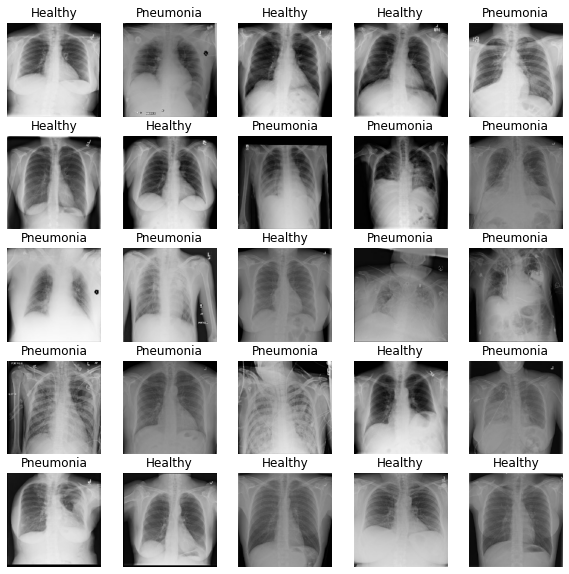

In [163]:
image_batch, label_batch = next(train_data_gen)
show_batch(image_batch, label_batch)

In [164]:
# Initiate model
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [165]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 7, 7, 1280)


In [166]:
# Freeze the convolutional base
base_model.trainable = False

In [167]:
base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_9[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
_______________________________________________________________________________

In [168]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [170]:
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [171]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [172]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [173]:
model.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_16  (None, 1280)              0         
_________________________________________________________________
dense_7 (Dense)              (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 3,843
Non-trainable params: 2,257,984
_________________________________________________________________


In [174]:
len(model.trainable_variables)

2

In [175]:
initial_epochs = 10
validation_steps =20

loss0,accuracy0 = model.evaluate(val_data_gen, steps = validation_steps)

20/20 [==============================] - 21s 1s/step - loss: 1.9982 - accuracy: 0.0609


In [176]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 2.00
initial accuracy: 0.06


In [177]:
history = model.fit(train_data_gen,
                    epochs=initial_epochs,
                    validation_data=val_data_gen)

Epoch 1/10
148/148 [==============================] - 202s 1s/step - loss: 0.8556 - accuracy: 0.5865 - val_loss: 0.6364 - val_accuracy: 0.7287
Epoch 2/10
148/148 [==============================] - 201s 1s/step - loss: 0.6011 - accuracy: 0.7406 - val_loss: 0.5702 - val_accuracy: 0.7602
Epoch 3/10
148/148 [==============================] - 231s 2s/step - loss: 0.5541 - accuracy: 0.7693 - val_loss: 0.5430 - val_accuracy: 0.7662
Epoch 4/10
148/148 [==============================] - 200s 1s/step - loss: 0.5258 - accuracy: 0.7809 - val_loss: 0.5249 - val_accuracy: 0.7721
Epoch 5/10
148/148 [==============================] - 205s 1s/step - loss: 0.5055 - accuracy: 0.7873 - val_loss: 0.5090 - val_accuracy: 0.7772
Epoch 6/10
148/148 [==============================] - 212s 1s/step - loss: 0.4900 - accuracy: 0.7947 - val_loss: 0.4957 - val_accuracy: 0.7806
Epoch 7/10
148/148 [==============================] - 210s 1s/step - loss: 0.4773 - accuracy: 0.7996 - val_loss: 0.4852 - val_accuracy: 0.7857

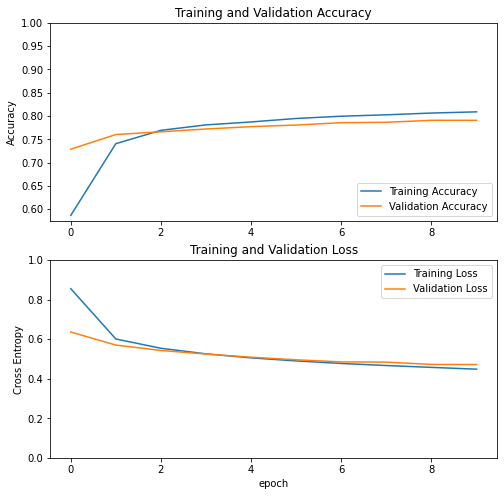

In [178]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [182]:
base_model.trainable = True

In [183]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

Number of layers in the base model:  155


In [184]:
# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [185]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.RMSprop(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [186]:
model.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_16  (None, 1280)              0         
_________________________________________________________________
dense_7 (Dense)              (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 1,866,435
Non-trainable params: 395,392
_________________________________________________________________


In [187]:
len(model.trainable_variables)

58

In [188]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_data_gen,
                         epochs = total_epochs,
                         initial_epoch =  history.epoch[-1],
                         validation_data = val_data_gen)

Epoch 10/20
148/148 [==============================] - 321s 2s/step - loss: 0.4540 - accuracy: 0.6684 - val_loss: 0.4027 - val_accuracy: 0.7619
Epoch 11/20
148/148 [==============================] - 319s 2s/step - loss: 0.3035 - accuracy: 0.8085 - val_loss: 0.3868 - val_accuracy: 0.7628
Epoch 12/20
148/148 [==============================] - 323s 2s/step - loss: 0.2666 - accuracy: 0.8340 - val_loss: 0.3408 - val_accuracy: 0.7832
Epoch 13/20
148/148 [==============================] - 314s 2s/step - loss: 0.2392 - accuracy: 0.8467 - val_loss: 0.3105 - val_accuracy: 0.8087
Epoch 14/20
148/148 [==============================] - 319s 2s/step - loss: 0.2155 - accuracy: 0.8684 - val_loss: 0.3020 - val_accuracy: 0.8129
Epoch 15/20
148/148 [==============================] - 331s 2s/step - loss: 0.1962 - accuracy: 0.8801 - val_loss: 0.2964 - val_accuracy: 0.8121
Epoch 16/20
148/148 [==============================] - 328s 2s/step - loss: 0.1761 - accuracy: 0.8947 - val_loss: 0.2945 - val_accuracy:

In [189]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

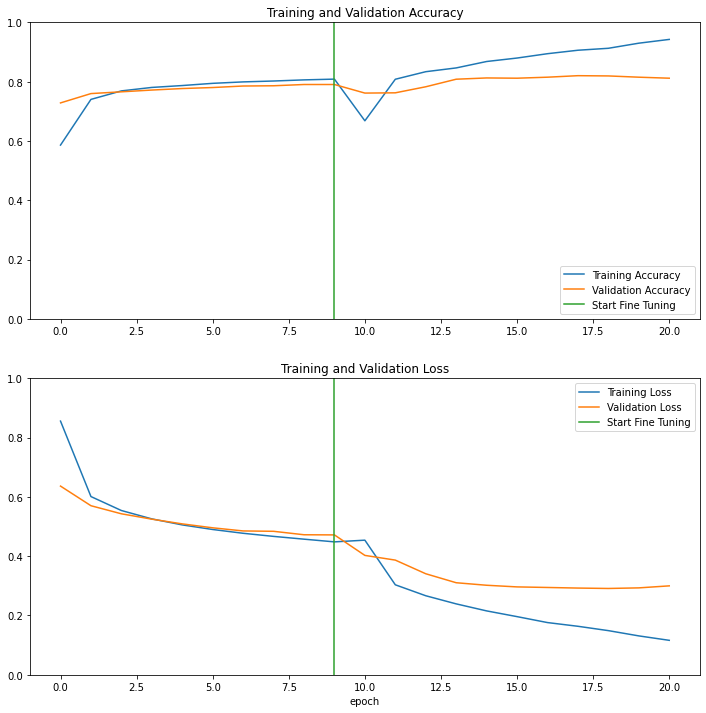

In [190]:
plt.figure(figsize=(12, 12))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# Tensorflow

In [395]:
import random
import shutil
from shutil import copytree

In [396]:
healthy = list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [397]:
print(f'healthy lungs: {len(healthy)} images')
print(f'pneumonia lungs: {len(pneumonia)} images')
print(f'coivd lungs: {len(covid)} images')

healthy lungs: 1573 images
pneumonia lungs: 2979 images
coivd lungs: 161 images


In [399]:
# Function to move files from train folder to test/val folder

def move_files(list, folder):
    for i in list:
        shutil.move(str(i), f'images/{folder}', copy_function=shutil.copy2)
    return 'Complete' 

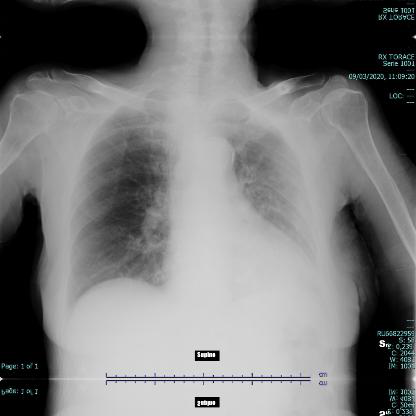

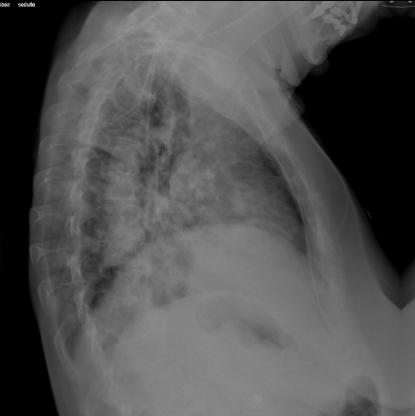

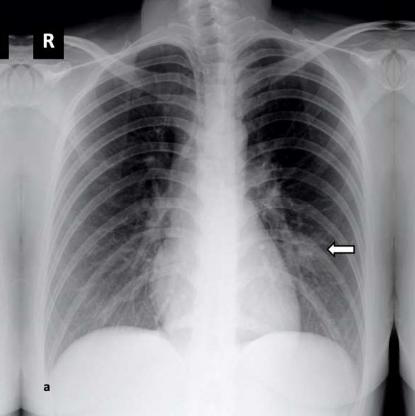

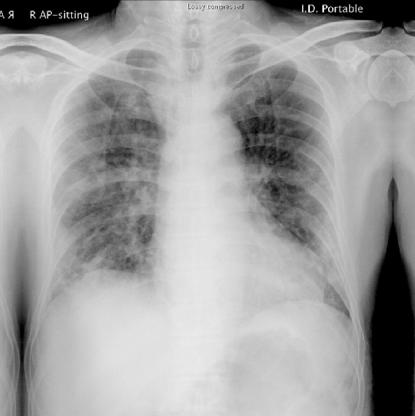

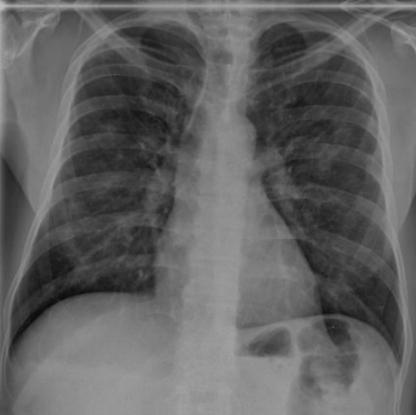

...

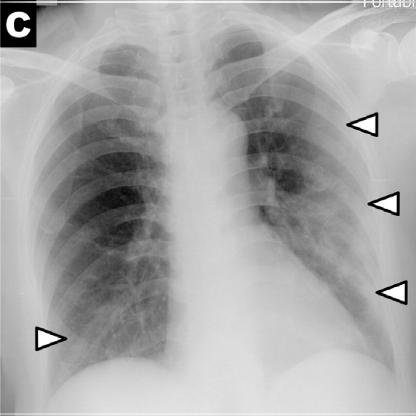

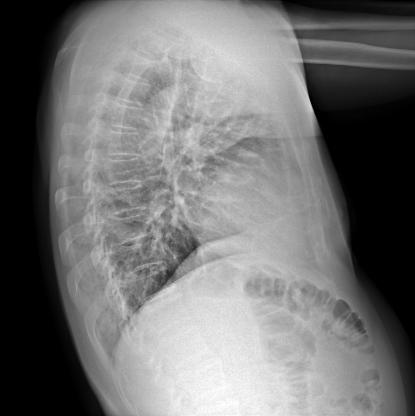

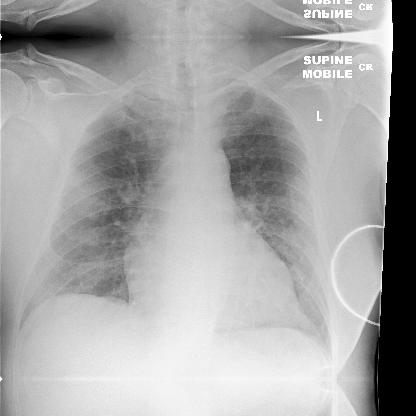

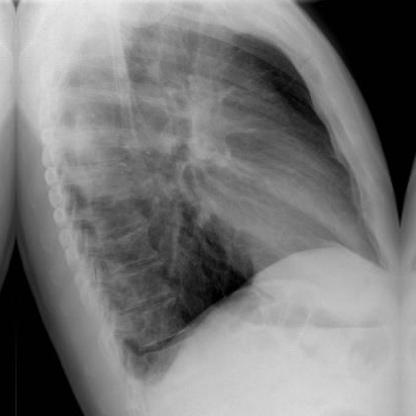

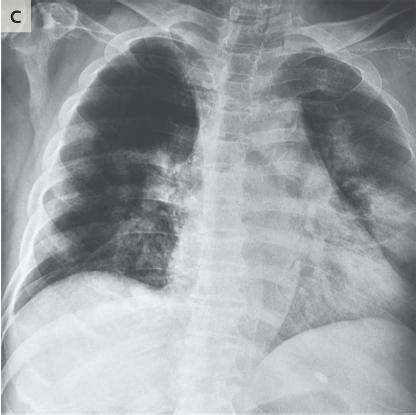

In [617]:
for image_path in list(data_dir_train.glob('*covid/*')):
    display.display(Image.open(str(image_path)))

In [572]:
# creating test subset
healthy_test = random.sample(healthy, int(len(healthy)*.1))
pneumonia_test = random.sample(pneumonia, int(len(pneumonia)*.1))
covid_test = random.sample(covid, int(len(covid)*.1))

move_files(healthy_test, 'test/healthy')
move_files(pneumonia_test, folder = 'test/pneumonia')
move_files(covid_test, folder = 'test/covid')

FileNotFoundError: [Errno 2] No such file or directory: 'images/train/healthy/bade0f31-c385-4f3f-b16f-bdcc83b2c687_jpg.rf.331934ab130566e6edd271a85be0f2f4.jpg'

In [401]:
# updating list of train images
data_dir = pathlib.Path('./images/train/')

healthy = list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [403]:
# creating val subset
healthy_val = random.sample(healthy, len(healthy_test))
pneumonia_val = random.sample(pneumonia, len(pneumonia_test))
covid_val = random.sample(covid, len(covid_test))

move_files(healthy_val, 'validation/healthy')
move_files(pneumonia_val, 'validation/pneumonia')
move_files(covid_val, 'validation/covid')

In [618]:
# train, val, test
data_dir_train = pathlib.Path('./images/train/')
data_dir_val = pathlib.Path('./images/validation/')
data_dir_test = pathlib.Path('./images/test/')

list_train = tf.data.Dataset.list_files(str(data_dir_train/'*/*'))
list_val = tf.data.Dataset.list_files(str(data_dir_val/'*/*'))
list_test = tf.data.Dataset.list_files(str(data_dir_test/'*/*'))

In [677]:
h = len(list(data_dir_train.glob('*healthy/*.jpg'))) + len(list(data_dir_train.glob('*pneumonia/*.jpg')))  + len(list(data_dir_train.glob('*covid/*.jpg')))
v = len(list(data_dir_val.glob('*healthy/*.jpg'))) + len(list(data_dir_val.glob('*pneumonia/*.jpg')))  + len(list(data_dir_val.glob('*covid/*.jpg')))
t = len(list(data_dir_test.glob('*healthy/*.jpg'))) + len(list(data_dir_test.glob('*pneumonia/*.jpg')))  + len(list(data_dir_test.glob('*covid/*.jpg')))

print(f'train dataset: {h} images')
print(f'validation dataset: {v} images')
print(f'test dataset: {t} images')

train dataset: 3760 images
validation dataset: 1057 images
test dataset: 1070 images


In [679]:
h+v+t

5887

In [619]:
# checking lists for train, val, and test
for f in list_train.take(2):
  print(f.numpy())

for f in list_val.take(2):
  print(f.numpy())

for f in list_test.take(2):
  print(f.numpy())

b'images/train/pneumonia/b1f74e4d-e64a-4555-b60e-8dad24766fd5_jpg.rf.feb749800ffa22308c1b1415d0945caf.jpg'
b'images/train/covid/covid-19-caso-70-1-PA_jpg.rf.aea09e6cf2f903ff16ad8fe5a045e917.jpg'
b'images/validation/pneumonia/62ead050-f18d-44da-b85e-7b37d59fd402_jpg.rf.23a134218a411cb1c180f53d2be5bcbe.jpg'
b'images/validation/pneumonia/f5dd9e14-95a4-4d0b-8589-4a0001486e94_jpg.rf.541c546999742c2dec8c09057aa74397.jpg'
b'images/test/pneumonia/e2e682a3-7e73-480c-aa62-78df6eabdff6_jpg.rf.319f7e4eef671992899c04abe8d4c090.jpg'
b'images/test/pneumonia/395cb95f-700c-4a77-89f1-dcbddf957552_jpg.rf.4dd03102048a495c8a6484e521388aa1.jpg'


In [620]:
def get_label(file_path):
  # convert the path to a list of path components
  parts = tf.strings.split(file_path, os.path.sep)
  # The second to last is the class-directory
  return parts[-2] == CLASS_NAMES

In [621]:
def decode_img(img):
    # convert the compressed string to a 3D uint8 tensor
    img = tf.image.decode_jpeg(img, channels=3)
    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    # img = (img/127.5) - 1   
    img = tf.image.convert_image_dtype(img, tf.float32)
    # resize the image to the desired size.
    return tf.image.resize(img, [IMG_WIDTH, IMG_HEIGHT])

In [622]:
def process_path(file_path):
    label = get_label(file_path)
    # load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = decode_img(img)
    return img, label

In [623]:
# Set `num_parallel_calls` so multiple images are loaded/processed in parallel.

IMG_WIDTH = 160
IMG_HEIGHT = 160

labeled_train = list_train.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_test = list_test.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_val = list_val.map(process_path, num_parallel_calls=AUTOTUNE)

In [624]:
for image, label in labeled_train.take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

Image shape:  (160, 160, 3)
Label:  [ True False False]


In [625]:
for image_test, label_test in labeled_test.take(1):
  print("Image shape: ", image_test.numpy().shape)
  print("Label: ", label_test.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [626]:
for image_val, label_val in labeled_val.take(1):
  print("Image shape: ", image_val.numpy().shape)
  print("Label: ", label_val.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [627]:
def prepare_for_training(ds, cache=True, shuffle_buffer_size=1000):

  if cache:
    if isinstance(cache, str):
      ds = ds.cache(cache)
    else:
      ds = ds.cache()

  ds = ds.shuffle(buffer_size=shuffle_buffer_size)

  # Repeat forever
  ds = ds.repeat()

  ds = ds.batch(BATCH_SIZE)

  # `prefetch` lets the dataset fetch batches in the background while the model
  # is training.
  ds = ds.prefetch(buffer_size=AUTOTUNE)

  return ds

In [628]:
train_ds = prepare_for_training(labeled_train)
image_batch_train, label_batch_train = next(iter(train_ds))

val_ds = prepare_for_training(labeled_val)
image_batch_val, label_batch_val = next(iter(test_ds))

test_ds = prepare_for_training(labeled_test)
image_batch_test, label_batch_test = next(iter(test_ds))

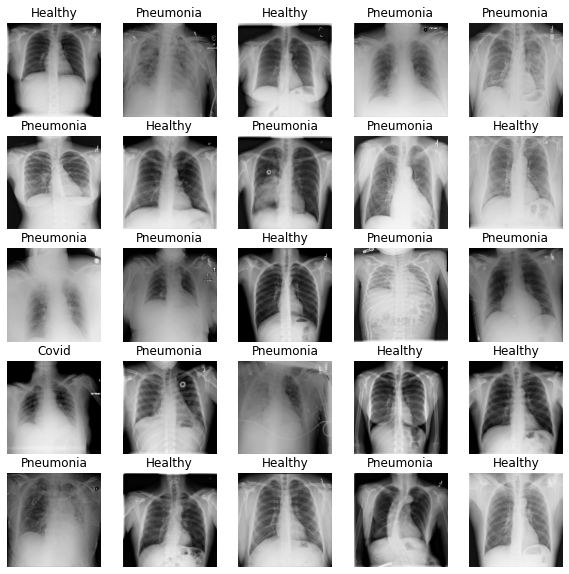

In [629]:
show_batch(image_batch_train.numpy(), label_batch_train.numpy())

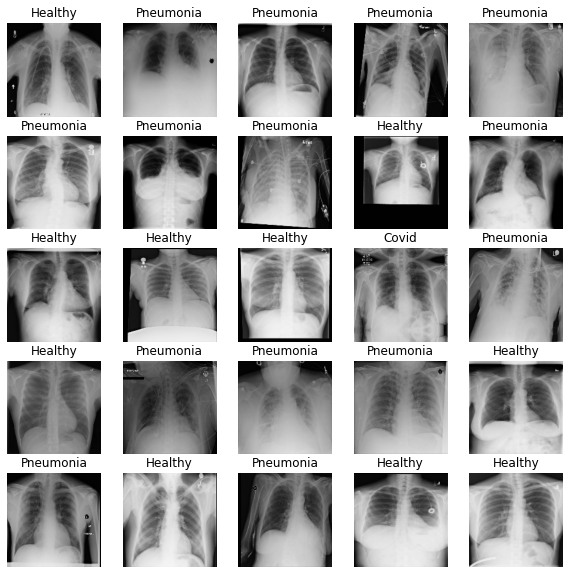

In [630]:
show_batch(image_batch_val.numpy(), label_batch_val.numpy())

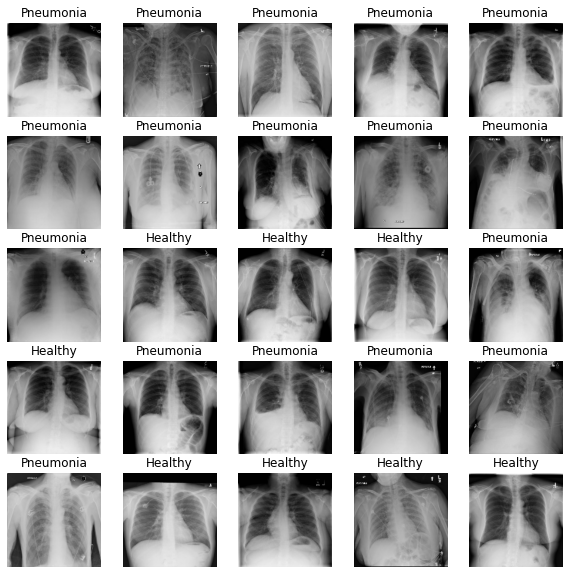

In [631]:
show_batch(image_batch_test.numpy(), label_batch_test.numpy())

In [632]:
for image_batch, label_batch in train_ds.take(1):
   pass

image_batch.shape

TensorShape([32, 160, 160, 3])

In [633]:
# Model

In [634]:
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [635]:
# Feature Extraction
# Freeze the convolutional base
base_model.trainable = False

In [636]:
base_model.summary()

Model: "mobilenetv2_1.00_160"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 161, 161, 3)  0           input_19[0][0]                   
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 80, 80, 32)   864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 80, 80, 32)   128         Conv1[0][0]                      
_______________________________________________________________________________

In [637]:
# Classification head
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [638]:
# single prediction per image 
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [639]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [640]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [641]:
model.summary()

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_160 (Model) (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_24  (None, 1280)              0         
_________________________________________________________________
dense_16 (Dense)             (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 3,843
Non-trainable params: 2,257,984
_________________________________________________________________


In [642]:
len(model.trainable_variables)

2

In [643]:
initial_epochs = 10
validation_steps = 20

loss0,accuracy0 = model.evaluate(val_ds, steps = validation_steps)

20/20 [==============================] - 12s 602ms/step - loss: 1.2684 - accuracy: 0.3063


In [644]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 1.27
initial accuracy: 0.31


In [657]:
image_count = len(list(data_dir_train.glob('*/*.jpg')))
image_count_v = len(list(data_dir_val.glob('*/*.jpg')))

In [658]:
step = np.ceil(image_count/BATCH_SIZE)
v_step = np.ceil(image_count_v/BATCH_SIZE)

history_tf = model.fit(train_ds,
                       epochs=initial_epochs,
                       steps_per_epoch = step,
                       validation_data=val_ds,
                       validation_steps = v_step)

Epoch 1/10
118/118 [==============================] - 98s 831ms/step - loss: 0.6167 - accuracy: 0.7233 - val_loss: 0.5611 - val_accuracy: 0.7601
Epoch 2/10
118/118 [==============================] - 102s 864ms/step - loss: 0.5498 - accuracy: 0.7699 - val_loss: 0.5296 - val_accuracy: 0.7767
Epoch 3/10
118/118 [==============================] - 93s 792ms/step - loss: 0.5170 - accuracy: 0.7892 - val_loss: 0.4972 - val_accuracy: 0.7895
Epoch 4/10
118/118 [==============================] - 95s 806ms/step - loss: 0.4923 - accuracy: 0.7953 - val_loss: 0.4840 - val_accuracy: 0.7849
Epoch 5/10
118/118 [==============================] - 95s 801ms/step - loss: 0.4755 - accuracy: 0.8046 - val_loss: 0.4689 - val_accuracy: 0.7950
Epoch 6/10
118/118 [==============================] - 92s 783ms/step - loss: 0.4653 - accuracy: 0.8077 - val_loss: 0.4558 - val_accuracy: 0.7960
Epoch 7/10
118/118 [==============================] - 97s 824ms/step - loss: 0.4525 - accuracy: 0.8146 - val_loss: 0.4608 - val_a

In [691]:
np.argmax(model.predict(test_ds, steps = 1), axis=-1) # change steps to number of batches

array([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1,
       1, 1, 0, 2, 1, 0, 1, 1, 1, 1])

In [692]:
len(np.argmax(model.predict(test_ds, steps = 1), axis=-1))

32

In [696]:
dir(test_ds)

['_GeneratorState',
 '__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_add_variable_with_custom_getter',
 '_apply_options',
 '_as_serialized_graph',
 '_buffer_size',
 '_checkpoint_dependencies',
 '_consumers',
 '_deferred_dependencies',
 '_flat_shapes',
 '_flat_structure',
 '_flat_types',
 '_functions',
 '_gather_saveables_for_checkpoint',
 '_graph',
 '_graph_attr',
 '_handle_deferred_dependencies',
 '_has_captured_ref',
 '_input_dataset',
 '_inputs',
 '_list_extra_dependencies_for_serialization',
 '_list_functions_for_serialization',
 '_lookup_dependency',
 '_maybe_initialize_trackable',
 '_name_based_attribute_restore

In [ ]:
y = []
counter = 0
for a, b in test_ds:
    if counter == int(/32)
    for i in b:
        y.append(np.argmax(i))
print(y)

In [695]:
model.get_weights()

[array([[[[ 7.51734003e-02,  2.11393330e-02, -8.61470163e-01,
            1.35980397e-01,  9.89127811e-03,  1.42140016e-01,
            6.25003934e-01,  1.50594607e-01,  2.05895714e-02,
            2.81278112e-22, -1.14358437e-21, -2.27494485e-22,
           -3.27495903e-01, -9.08321049e-03,  1.29852386e-03,
            1.84906259e-01,  1.51867405e-01, -1.76067978e-01,
           -1.50455639e-01,  2.06756033e-02,  5.94916864e-23,
            1.41179981e-03,  6.17588401e-01,  3.74927633e-02,
            1.79815572e-02,  2.04572105e-03,  1.29552171e-01,
            6.81161929e-22,  3.64851556e-03, -4.71202396e-02,
           -5.23118713e-21,  3.10034745e-21],
          [ 3.49049985e-01, -6.10829890e-02,  5.23225546e-01,
            2.45421678e-01,  2.46485951e-03, -1.03372492e-01,
            1.03341877e+00,  3.13968539e-01,  1.83513258e-02,
            3.37590639e-22, -1.15860822e-21,  2.21702453e-22,
           -9.38358679e-02, -7.35998899e-02,  3.62410322e-02,
            2.31308311e-

In [699]:
dir(labeled_test)

['_GeneratorState',
 '__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_add_variable_with_custom_getter',
 '_apply_options',
 '_as_serialized_graph',
 '_checkpoint_dependencies',
 '_consumers',
 '_deferred_dependencies',
 '_deterministic',
 '_flat_shapes',
 '_flat_structure',
 '_flat_types',
 '_functions',
 '_gather_saveables_for_checkpoint',
 '_graph',
 '_graph_attr',
 '_handle_deferred_dependencies',
 '_has_captured_ref',
 '_input_dataset',
 '_inputs',
 '_list_extra_dependencies_for_serialization',
 '_list_functions_for_serialization',
 '_lookup_dependency',
 '_map_func',
 '_maybe_initialize_trackable',
 '_name_based_a

In [ ]:
np.argmax(model.(test_ds, steps = 1), axis=-1) # change steps to number of batches

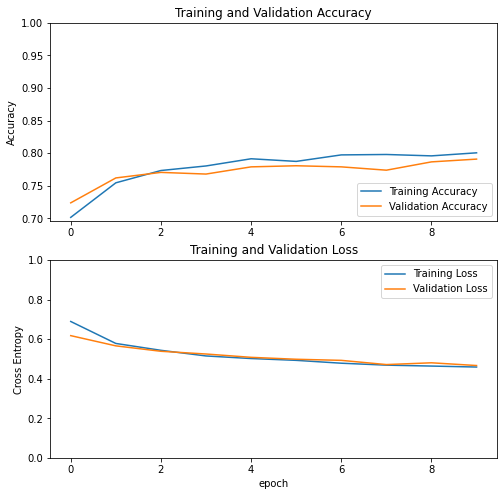

In [659]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [660]:
base_model.trainable = True

In [661]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  155


In [662]:
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [663]:
model.summary()

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_160 (Model) (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_24  (None, 1280)              0         
_________________________________________________________________
dense_16 (Dense)             (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 1,866,435
Non-trainable params: 395,392
_________________________________________________________________


In [664]:
len(model.trainable_variables)

58

In [666]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine_tf = model.fit(train_ds,
                            epochs=total_epochs,
                            steps_per_epoch = step,
                            initial_epoch =  history_tf.epoch[-1],
                            validation_data=val_ds,
                            validation_steps = v_step)

Epoch 10/20
118/118 [==============================] - 154s 1s/step - loss: 0.9784 - accuracy: 0.5877 - val_loss: 0.5966 - val_accuracy: 0.7794
Epoch 11/20
118/118 [==============================] - 201s 2s/step - loss: 0.4988 - accuracy: 0.8032 - val_loss: 0.5778 - val_accuracy: 0.7776
Epoch 12/20
118/118 [==============================] - 158s 1s/step - loss: 0.4238 - accuracy: 0.8313 - val_loss: 0.5073 - val_accuracy: 0.8051
Epoch 13/20
118/118 [==============================] - 144s 1s/step - loss: 0.3625 - accuracy: 0.8506 - val_loss: 0.4784 - val_accuracy: 0.8125
Epoch 14/20
118/118 [==============================] - 148s 1s/step - loss: 0.3243 - accuracy: 0.8713 - val_loss: 0.4602 - val_accuracy: 0.8199
Epoch 15/20
118/118 [==============================] - 146s 1s/step - loss: 0.2898 - accuracy: 0.8837 - val_loss: 0.4400 - val_accuracy: 0.8263
Epoch 16/20
118/118 [==============================] - 143s 1s/step - loss: 0.2611 - accuracy: 0.9041 - val_loss: 0.4343 - val_accuracy:

In [667]:
acc += history_fine_tf.history['accuracy']
val_acc += history_fine_tf.history['val_accuracy']

loss += history_fine_tf.history['loss']
val_loss += history_fine_tf.history['val_loss']

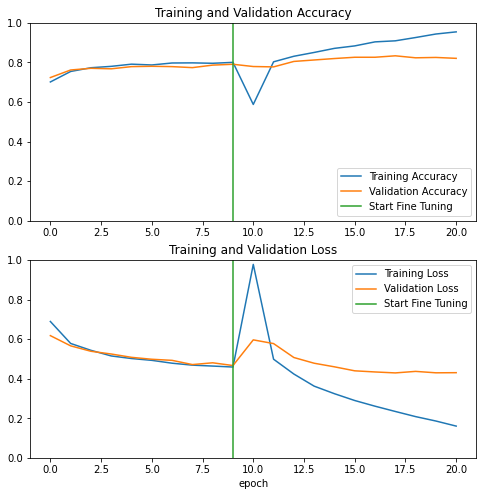

In [669]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# KERAS 4

In [307]:
# The 1./255 is to convert from uint8 to float32 in range [0,1].
random_state = 42
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255, validation_split=0.2, zca_whitening = True, horizontal_flip = True, vertical_flip = True )

In [218]:
1176/(1176+4711)

0.19976218787158145

In [219]:
BATCH_SIZE = 32
IMG_HEIGHT = 416
IMG_WIDTH = 416

In [260]:
data_dir

PosixPath('images/train')

In [220]:
train_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='training')
val_data_gen = image_generator.flow_from_directory(directory=str(data_dir),
                                                     batch_size=BATCH_SIZE,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     classes = list(CLASS_NAMES),
                                                     subset='validation')

Found 4711 images belonging to 3 classes.
Found 1176 images belonging to 3 classes.


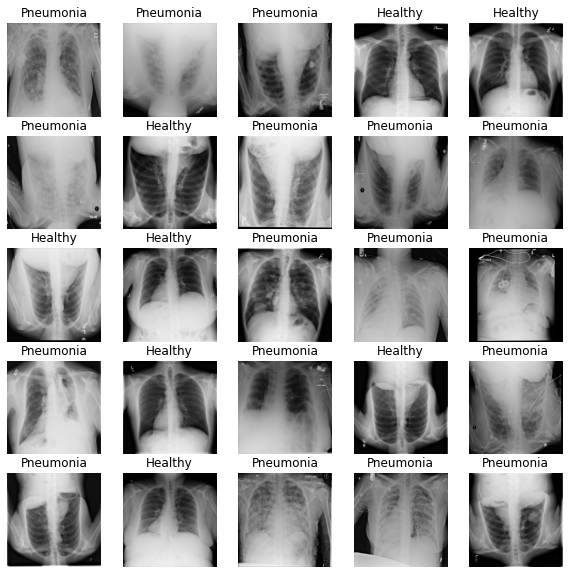

In [221]:
image_batch, label_batch = next(train_data_gen)
show_batch(image_batch, label_batch)

In [222]:
# Initiate model
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [223]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 13, 13, 1280)


In [224]:
# Freeze the convolutional base
base_model.trainable = False

In [225]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [226]:
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [227]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [228]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [229]:
initial_epochs = 10
validation_steps =20

loss0,accuracy0 = model.evaluate(val_data_gen, steps = validation_steps)

20/20 [==============================] - 80s 4s/step - loss: 1.2005 - accuracy: 0.4094


In [230]:
history = model.fit(train_data_gen,
                    epochs=initial_epochs,
                    validation_data=val_data_gen)

Epoch 1/10
148/148 [==============================] - 820s 6s/step - loss: 0.8811 - accuracy: 0.5786 - val_loss: 0.7592 - val_accuracy: 0.6378
Epoch 2/10
 17/148 [==>...........................] - ETA: 7:25 - loss: 0.6976 - accuracy: 0.6489

KeyboardInterrupt: 

In [214]:
history

In [215]:
import split_folders

In [216]:
split_folders.ratio('input_folder', output="output", seed=1337, ratio=(.8, .1, .1))

Copying files: 0 files [00:00, ? files/s]

FileNotFoundError: [Errno 2] No such file or directory: 'input_folder'